# Visualisation for IBAtS Gold Standard

### Import Modules

In [1]:
import os
import json
import cv2
import numpy as npshutil
import shutil
import matplotlib.pyplot as plt
plt.rcParams.update({'figure.max_open_warning': 0})
%matplotlib inline
from IBAtS_global import ROOT_DIR, NUMERALS, HEXDEC

### Function Definition

In [2]:
def rgb(triplet):
    return HEXDEC[triplet[0:2]], HEXDEC[triplet[2:4]], HEXDEC[triplet[4:6]]


def bgr(rgb_val):
    return rgb_val[2], rgb_val[1], rgb_val[0]

In [3]:
def visualise_gold_json(img, gold_json, fname):
    # gold detections
    faces = gold_json
    for face in faces:
        (x, y, w, h, color) = (face['x'], face['y'], face['width'], face['height'], face['color'])
        cv2.rectangle(img, (x, y), (x+w, y+h), bgr(rgb(color[1:])), 2)  
    
    plt.figure(figsize=(10,10))
    figure_text = 'Filename: {fname}\n'.format(fname=fname) 
    plt.text(0, 0, figure_text, horizontalalignment='left', verticalalignment='bottom', color='green', fontsize=13)
    
    plt.imshow(cv2.cvtColor(src=img, code=cv2.COLOR_BGR2RGB))

In [4]:
def gold_standard_visualiser(filepath):
    fnames = os.listdir(filepath)
    for fname in fnames:
        if fname.startswith('[resize]') and fname.endswith('.jpg'):
            img = cv2.imread(os.path.join(filepath, fname))
            
            json_fname = '{fname}.gold.json'.format(fname=fname[:-4])
            
            # if image gold json not exist then adopt image json
            if json_fname not in fnames:
                shutil.copyfile(os.path.join(filepath,'{fname}.json'.format(fname=fname[:-4])), 
                                os.path.join(filepath, json_fname)) 
            
            with open(os.path.join(filepath, json_fname), 'r+') as json_file:
                gold_json = json.load(json_file)
            
            visualise_gold_json(img, gold_json, os.path.join(filepath, fname))

### Main Function

In [5]:
def main():
    classrooms = os.listdir(ROOT_DIR)
    
    classroom = classrooms[0]
#     classroom = classrooms[1]
#     classroom = classrooms[2]
#     classroom = classrooms[3]
#     classroom = classrooms[4]
#     classroom = classrooms[5]
#     classroom = classrooms[6]
    
    dates = os.listdir(os.path.join(ROOT_DIR, classroom))
    for date in dates:
        filepath = os.path.join(ROOT_DIR, classroom, date)
        print('Processing {}'.format(filepath))
        gold_standard_visualiser(filepath=filepath)

Processing ./IBAtS_Initial_Dataset/BS301/2017_10_30
Processing ./IBAtS_Initial_Dataset/BS301/2017_09_18
Processing ./IBAtS_Initial_Dataset/BS301/2017_11_27
Processing ./IBAtS_Initial_Dataset/BS301/2017_11_13
Processing ./IBAtS_Initial_Dataset/BS301/2017_10_02
Processing ./IBAtS_Initial_Dataset/BS301/2017_09_04
Processing ./IBAtS_Initial_Dataset/BS301/2017_09_11
Processing ./IBAtS_Initial_Dataset/BS301/2017_10_23
Processing ./IBAtS_Initial_Dataset/BS301/2017_11_20
Processing ./IBAtS_Initial_Dataset/BS301/2017_09_25
Processing ./IBAtS_Initial_Dataset/BS301/2017_12_04


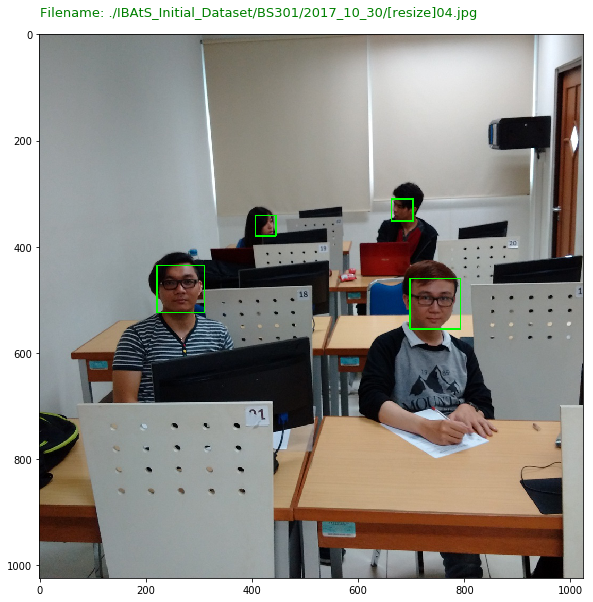

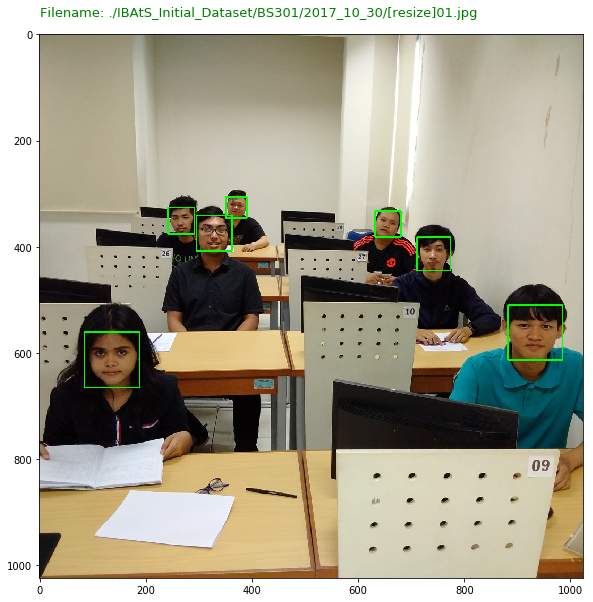

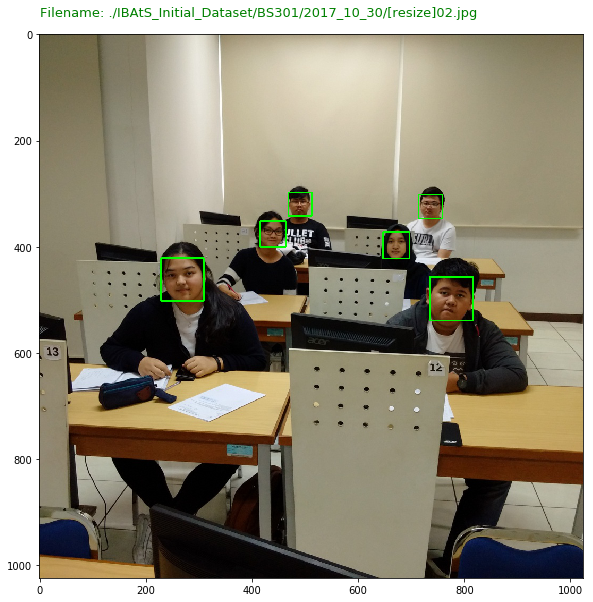

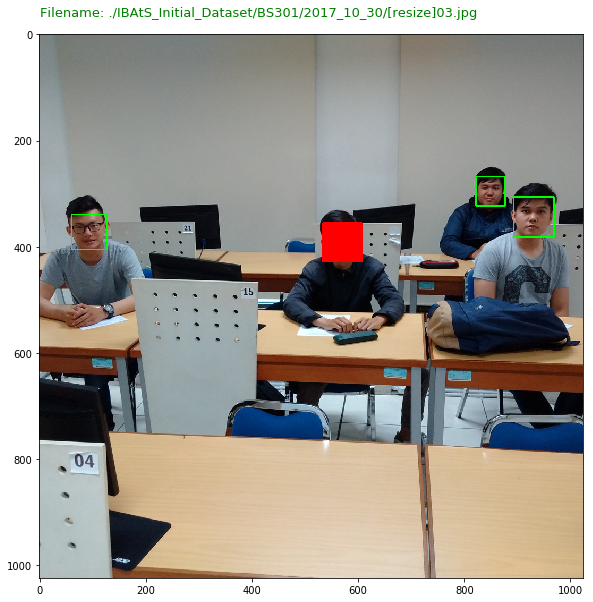

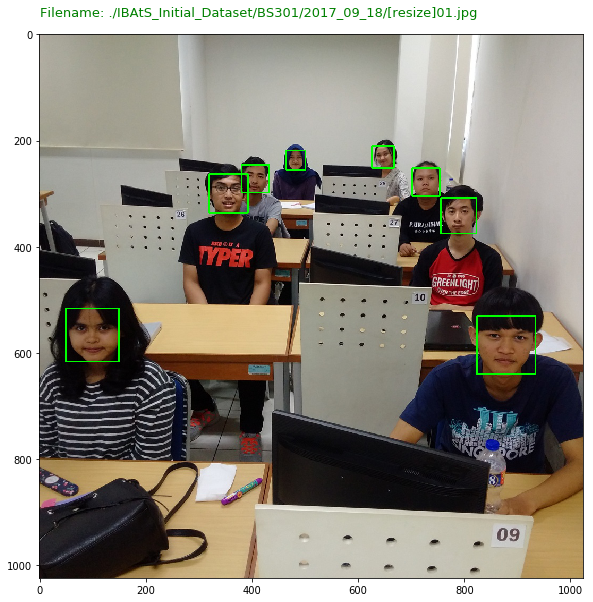

...

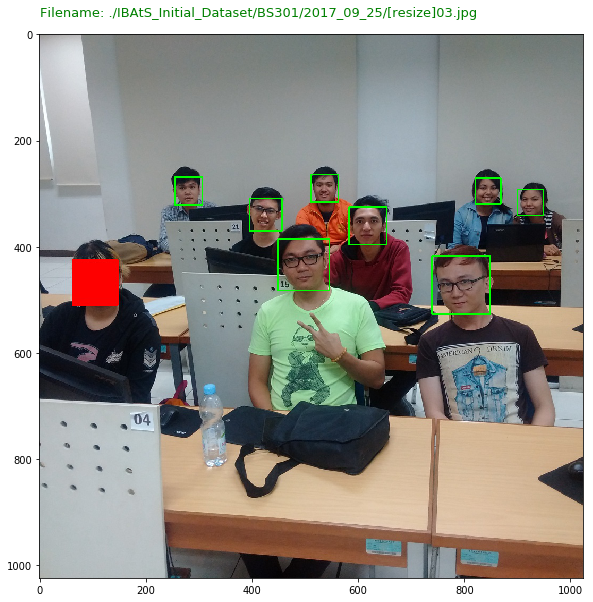

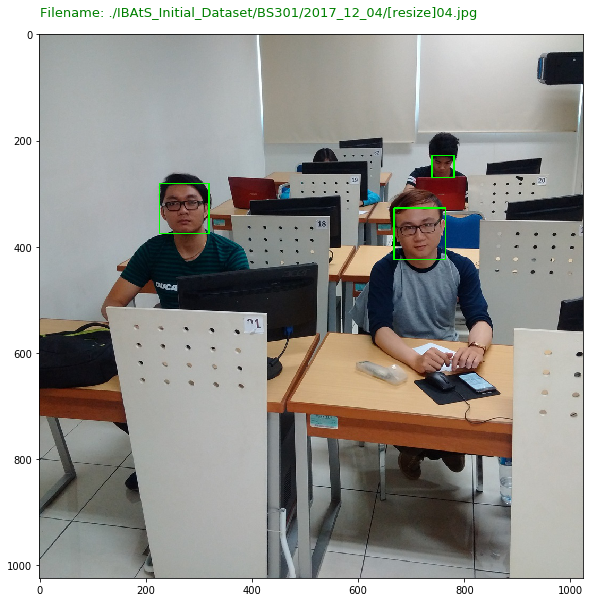

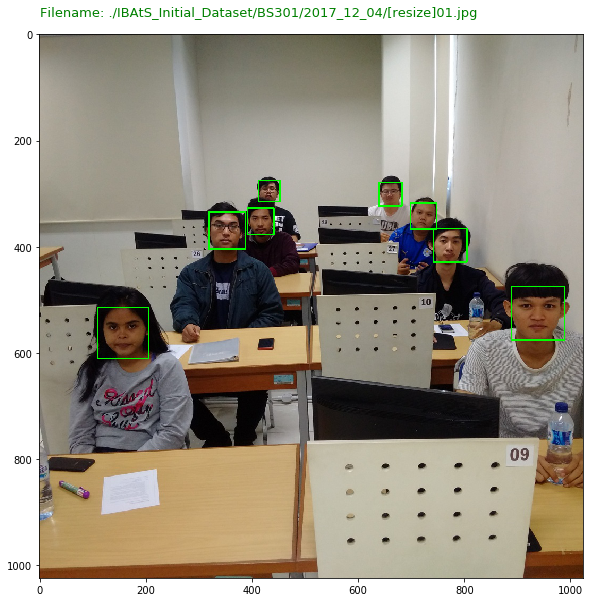

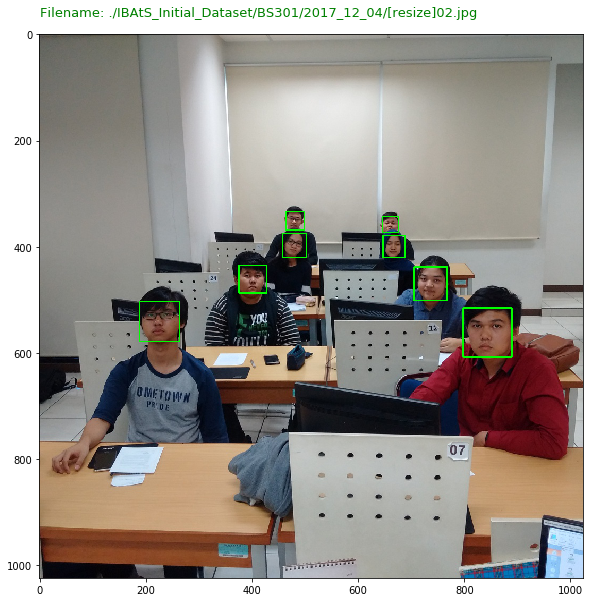

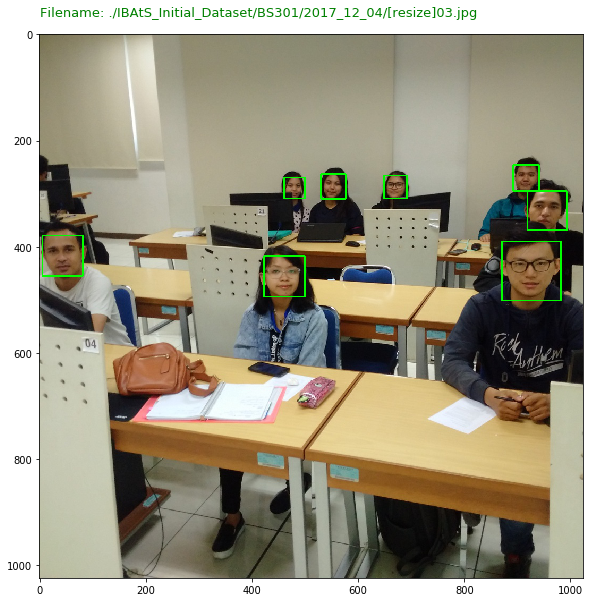

In [6]:
main()